---
---

<h1 style="color:#1f77b4;">GAN-Based Image Inpainting Template Project</h1>

This repository contains a template implementation of a Generative Adversarial Network (GAN) for image inpainting using the <strong><a href="https://www.kaggle.com/datasets/jessicali9530/celeba-dataset" target="_blank">CelebA dataset</a></strong>. The model learns to fill in missing regions of face images with plausible content.

<h2 style="color:#ff7f0e;">Project Overview</h2>

- Download and preprocess the CelebA dataset using this code:  
<pre><code>import kagglehub
path = kagglehub.dataset_download("jessicali9530/celeba-dataset")
print("Path to dataset files:", path)
</code></pre>

- Create masked images with center and random square masks.

- Build and train a GAN consisting of a generator and discriminator for image inpainting.

- Evaluate model performance using PSNR and SSIM metrics.

- Visualize training progress and inpainting results.

- Save trained models and training metrics.

<h2 style="color:#2ca02c;">Files and Key Code Components</h2>

- <strong>Dataset download & inspection:</strong>  
Download and inspect the <a href="https://www.kaggle.com/datasets/jessicali9530/celeba-dataset" target="_blank">CelebA dataset</a> using <code>kagglehub</code>.

- <strong>Image preprocessing:</strong>  
Scripts for loading images from <code>path</code>, resizing to 128x128, normalizing, and applying masks (center and random).

- <strong>Model architecture:</strong>  
Functions <code>build_generator()</code> and <code>build_discriminator()</code> define the GAN networks using TensorFlow/Keras.

- <strong>Training pipeline:</strong>  
Includes training loops, loss functions, and evaluation using PSNR and SSIM.

- <strong>Visualization and saving outputs:</strong>  
Shows sample inpainting results per epoch and saves models and metrics plots.

<h2 style="color:#d62728;">Usage</h2>

- Run the dataset download and inspection cell to acquire and view dataset files at the variable <code>path</code>.

- Load and preprocess images with masking.

- Build GAN models with <code>build_generator()</code> and <code>build_discriminator()</code>.

- Train for desired epochs (default 10).

- Visualize results and save trained models to <code>saved_models/</code>.

- Check training metrics plot saved in <code>outputs/training_metrics.png</code>.

<h2 style="color:#9467bd;">Notes</h2>

- <strong>Performance Disclaimer:</strong>  
This is a template project and not fully optimized. Inpainting results may be limited by simple architecture, minimal preprocessing, and short training time.

- Use as a starting point for improvements such as deeper networks, advanced losses, longer training, better masks, and hyperparameter tuning.

- <strong>Important:</strong> For access to the actual production-ready model with improved accuracy and performance, or for any collaboration, please contact me directly.

<h2 style="color:#8c564b;">Contact & Collaboration</h2>

For questions, suggestions, or to request the production model, reach me at:  
<strong>ericmwaniki2004@gmail.com</strong>

<h2 style="color:#e377c2;">Acknowledgments</h2>

- CelebA dataset by <a href="https://www.kaggle.com/datasets/jessicali9530/celeba-dataset" target="_blank">jessicali9530/celeba-dataset</a>

- TensorFlow and Keras deep learning frameworks

---
---

----
----

In [2]:
import warnings

In [3]:
warnings.filterwarnings("ignore")

In [4]:
import os

In [5]:
import kagglehub

In [6]:
import numpy as np

In [7]:
from PIL import Image

In [8]:
from tqdm import tqdm

In [9]:
import matplotlib.pyplot as plt

In [10]:
import pandas as pd

In [11]:
import random

In [12]:
import tensorflow as tf

In [13]:
from tensorflow.keras import layers

---
---

---
---

In [14]:
# Download CelebA dataset and inspect

In [15]:
path = kagglehub.dataset_download("jessicali9530/celeba-dataset")

In [16]:
print("Dataset downloaded to:", path)

Dataset downloaded to: /kaggle/input/celeba-dataset


In [17]:
# List all files and folders in the dataset

In [18]:
for root, dirs, files in os.walk(path):
    print("Directory:", root)
    for fname in files[:10]:  # show first 10 files in each dir
        print("   ", fname)

Directory: /kaggle/input/celeba-dataset
    list_landmarks_align_celeba.csv
    list_eval_partition.csv
    list_attr_celeba.csv
    list_bbox_celeba.csv
Directory: /kaggle/input/celeba-dataset/img_align_celeba
Directory: /kaggle/input/celeba-dataset/img_align_celeba/img_align_celeba
    083648.jpg
    168202.jpg
    125778.jpg
    059339.jpg
    032501.jpg
    160139.jpg
    046754.jpg
    178961.jpg
    123482.jpg
    039337.jpg


----
---

---
---

In [19]:
# Locate and count images

In [20]:
img_dir = os.path.join(path, "img_align_celeba", "img_align_celeba")

In [21]:
image_files = sorted([f for f in os.listdir(img_dir) if f.endswith(".jpg")])

In [22]:
print("Total number of images:", len(image_files))
print("First 20 image names:", image_files[:20])

Total number of images: 202599
First 20 image names: ['000001.jpg', '000002.jpg', '000003.jpg', '000004.jpg', '000005.jpg', '000006.jpg', '000007.jpg', '000008.jpg', '000009.jpg', '000010.jpg', '000011.jpg', '000012.jpg', '000013.jpg', '000014.jpg', '000015.jpg', '000016.jpg', '000017.jpg', '000018.jpg', '000019.jpg', '000020.jpg']


In [26]:
# Inspect and show 20 sample images

000001.jpg - Size: (178, 218) - Mode: RGB
000002.jpg - Size: (178, 218) - Mode: RGB
000003.jpg - Size: (178, 218) - Mode: RGB
000004.jpg - Size: (178, 218) - Mode: RGB
000005.jpg - Size: (178, 218) - Mode: RGB
000006.jpg - Size: (178, 218) - Mode: RGB
000007.jpg - Size: (178, 218) - Mode: RGB
000008.jpg - Size: (178, 218) - Mode: RGB
000009.jpg - Size: (178, 218) - Mode: RGB
000010.jpg - Size: (178, 218) - Mode: RGB
000011.jpg - Size: (178, 218) - Mode: RGB
000012.jpg - Size: (178, 218) - Mode: RGB
000013.jpg - Size: (178, 218) - Mode: RGB
000014.jpg - Size: (178, 218) - Mode: RGB
000015.jpg - Size: (178, 218) - Mode: RGB
000016.jpg - Size: (178, 218) - Mode: RGB
000017.jpg - Size: (178, 218) - Mode: RGB
000018.jpg - Size: (178, 218) - Mode: RGB
000019.jpg - Size: (178, 218) - Mode: RGB
000020.jpg - Size: (178, 218) - Mode: RGB


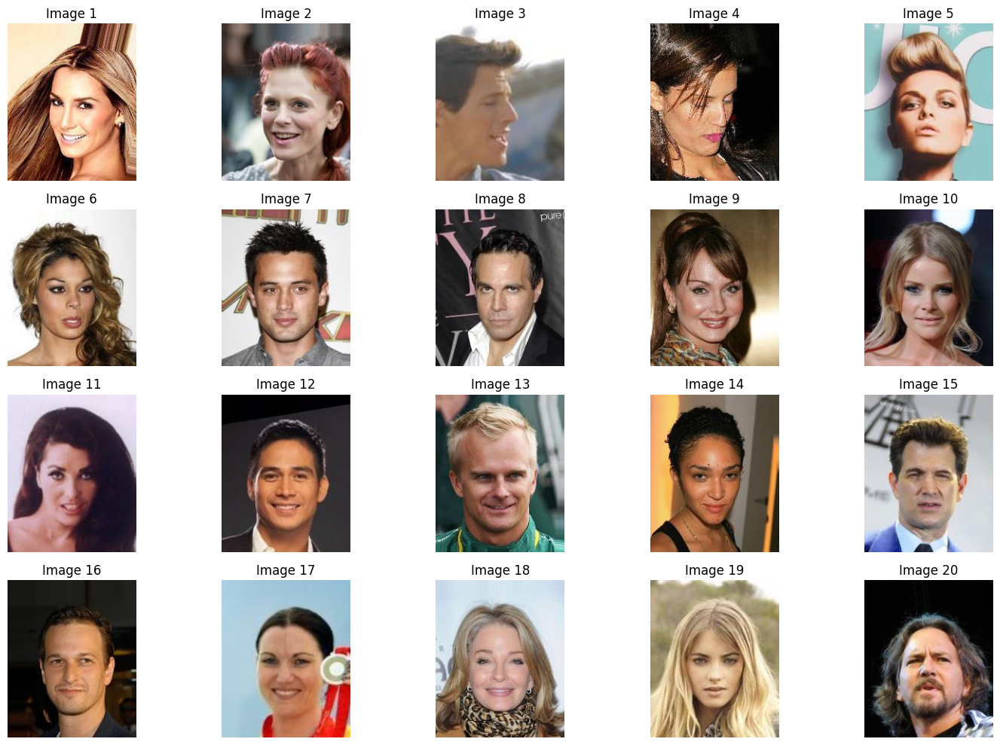

In [96]:
plt.figure(figsize=(15, 10))  # bigger figure for multiple rows
for i, fname in enumerate(image_files[:20]):
    img_path = os.path.join(img_dir, fname)
    img = Image.open(img_path)
    print(f"{fname} - Size: {img.size} - Mode: {img.mode}")

    plt.subplot(4, 5, i + 1)  # 4 rows, 5 columns
    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Image {i+1}")
plt.tight_layout()
plt.show()

In [28]:
# Read and print attribute file (if available)

In [29]:
attr_csv_path = os.path.join(path, "list_attr_celeba.csv")

In [30]:
if os.path.exists(attr_csv_path):
    df = pd.read_csv(attr_csv_path)
    print("Attribute file found")
    print("Shape:", df.shape)
    print(df.head())
else:
    print("Attribute CSV not found.")

Attribute file found
Shape: (202599, 41)
     image_id  5_o_Clock_Shadow  Arched_Eyebrows  Attractive  Bags_Under_Eyes  \
0  000001.jpg                -1                1           1               -1   
1  000002.jpg                -1               -1          -1                1   
2  000003.jpg                -1               -1          -1               -1   
3  000004.jpg                -1               -1           1               -1   
4  000005.jpg                -1                1           1               -1   

   Bald  Bangs  Big_Lips  Big_Nose  Black_Hair  ...  Sideburns  Smiling  \
0    -1     -1        -1        -1          -1  ...         -1        1   
1    -1     -1        -1         1          -1  ...         -1        1   
2    -1     -1         1        -1          -1  ...         -1       -1   
3    -1     -1        -1        -1          -1  ...         -1       -1   
4    -1     -1         1        -1          -1  ...         -1       -1   

   Straight_Hair  Wav

---
---

---
---

In [31]:
# # Image loading and preprocessing with center mask

In [32]:
def load_and_preprocess_images(image_dir, num_images=1000):
    original_images = []
    masked_images = []

    image_names = sorted(os.listdir(image_dir))[:num_images]

    for img_name in tqdm(image_names, desc='Loading and preprocessing'):
        img_path = os.path.join(image_dir, img_name)
        try:
            img = Image.open(img_path).convert('RGB')
            img = img.resize((128, 128))
            img_np = np.array(img) / 255.0  # Normalize to [0,1]

            # Create center mask
            masked_img = img_np.copy()
            mask_size = 64
            top = (128 - mask_size) // 2
            left = (128 - mask_size) // 2
            masked_img[top:top+mask_size, left:left+mask_size, :] = 0

            original_images.append(img_np)
            masked_images.append(masked_img)

        except Exception as e:
            print(f"Error loading {img_name}: {e}")

    return np.array(original_images), np.array(masked_images)

In [33]:
# Load images with center masking

In [34]:
original_images, masked_images = load_and_preprocess_images(img_dir, num_images=1000)

Loading and preprocessing: 100%|██████████| 1000/1000 [00:02<00:00, 442.66it/s]


In [90]:
# Visualize samples

In [92]:
num_images = 20

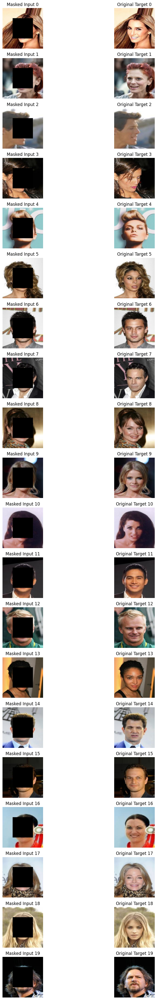

In [93]:
plt.figure(figsize=(12, num_images * 2))
for i in range(num_images):
    # Masked image subplot
    plt.subplot(num_images, 2, 2 * i + 1)
    plt.imshow(masked_images[i])
    plt.title(f"Masked Input {i}")
    plt.axis('off')

    # Original image subplot
    plt.subplot(num_images, 2, 2 * i + 2)
    plt.imshow(original_images[i])
    plt.title(f"Original Target {i}")
    plt.axis('off')
plt.tight_layout()
plt.show()

In [37]:
print("Original images shape:", original_images.shape)
print("Masked images shape:", masked_images.shape)

Original images shape: (1000, 128, 128, 3)
Masked images shape: (1000, 128, 128, 3)


In [38]:
# Functions for random masking

In [39]:
def create_random_mask(img_shape, mask_size=64):
    mask = np.ones(img_shape[:2], dtype=np.float32)
    x = random.randint(0, img_shape[1] - mask_size)
    y = random.randint(0, img_shape[0] - mask_size)
    mask[y:y+mask_size, x:x+mask_size] = 0.0
    return mask[..., np.newaxis]

In [40]:
def apply_mask(img, mask):
    return img * mask

In [41]:
# Example usage with random mask

In [42]:
img_name = "000001.jpg"

In [43]:
img = Image.open(os.path.join(img_dir, img_name)).convert('RGB').resize((128, 128))

In [44]:
img = np.array(img) / 255.0

In [45]:
mask = create_random_mask(img.shape)

In [46]:
masked_img = apply_mask(img, mask)

In [47]:
# Visualize original, mask, and masked image

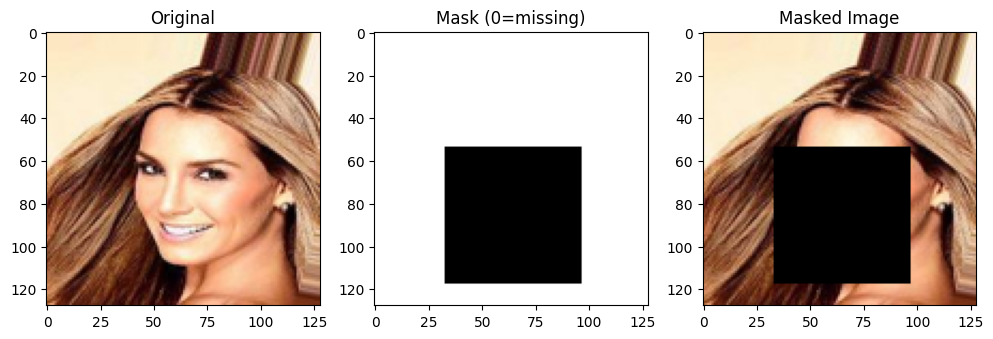

In [48]:
fig, ax = plt.subplots(1, 3, figsize=(12, 4))
ax[0].imshow(img)
ax[0].set_title('Original')
ax[1].imshow(mask.squeeze(), cmap='gray')
ax[1].set_title('Mask (0=missing)')
ax[2].imshow(masked_img)
ax[2].set_title('Masked Image')
plt.show()

---
---

In [49]:
# # GAN models

In [50]:
IMG_SIZE = 128

In [51]:
MASK_CHANNELS = 1

In [52]:
def build_generator():
    input_img = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    input_mask = layers.Input(shape=(IMG_SIZE, IMG_SIZE, MASK_CHANNELS))
    x = layers.Concatenate()([input_img, input_mask])
    x = layers.Conv2D(64, 4, strides=2, padding='same', activation='relu')(x)
    x = layers.Conv2D(128, 4, strides=2, padding='same', activation='relu')(x)
    x = layers.Conv2D(256, 4, strides=2, padding='same', activation='relu')(x)
    x = layers.Conv2DTranspose(128, 4, strides=2, padding='same', activation='relu')(x)
    x = layers.Conv2DTranspose(64, 4, strides=2, padding='same', activation='relu')(x)
    x = layers.Conv2DTranspose(3, 4, strides=2, padding='same', activation='sigmoid')(x)
    return tf.keras.Model(inputs=[input_img, input_mask], outputs=x)

In [53]:
def build_discriminator():
    input_img = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    x = layers.Conv2D(64, 4, strides=2, padding='same', activation=tf.nn.leaky_relu)(input_img)
    x = layers.Conv2D(128, 4, strides=2, padding='same', activation=tf.nn.leaky_relu)(x)
    x = layers.Conv2D(256, 4, strides=2, padding='same', activation=tf.nn.leaky_relu)(x)
    x = layers.Flatten()(x)
    x = layers.Dense(1)(x)
    return tf.keras.Model(inputs=input_img, outputs=x)

In [54]:
# Instantiate models

In [55]:
generator = build_generator()

In [56]:
discriminator = build_discriminator()

In [57]:
generator.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3             │ (None, 128, 128, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ input_layer_4             │ (None, 128, 128, 1)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_1             │ (None, 128, 128, 4)    │              0 │ input_layer_3[0][0],   │
│ (Concatenate)             │                        │                │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_6 (Conv2D)         │ (None, 64, 64, 64)     │          4,160 │ concatenate_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_7 (Conv2D)         │ (None, 32, 32, 128)    │        131,200 │ conv2d_6[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_8 (Conv2D)         │ (None, 16, 16, 256)    │        524,544 │ conv2d_7[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_transpose_3        │ (None, 32, 32, 128)    │        524,416 │ conv2d_8[0][0]         │
│ (Conv2DTranspose)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_transpose_4        │ (None, 64, 64, 64)     │        131,136 │ conv2d_transpose_3[0]… │
│ (Conv2DTranspose)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_transpose_5        │ (None, 128, 128, 3)    │          3,075 │ conv2d_transpose_4[0]… │
│ (Conv2DTranspose)         │                        │                │                        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 1,318,531 (5.03 MB)

 Trainable params: 1,318,531 (5.03 MB)

 Non-trainable params: 0 (0.00 B)

In [58]:
discriminator.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)           │ (None, 128, 128, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 64, 64, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_10 (Conv2D)                   │ (None, 32, 32, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_11 (Conv2D)                   │ (None, 16, 16, 256)         │         524,544 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 65536)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │          65,537 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 724,417 (2.76 MB)

 Trainable params: 724,417 (2.76 MB)

 Non-trainable params: 0 (0.00 B)

---
---

---
---

In [89]:
# Training setup

In [88]:
#  Note before training:
# At this early training stage, the model's outputs will likely be noisy and
# far from perfect. The generator is still learning to reconstruct masked
# areas and the discriminator is getting trained to distinguish fake from real.
# Don't expect high-quality or realistic inpainting results yet — improvements
# come gradually over epochs.

# Additional pre-training considerations:
# - Initialize model weights carefully to avoid vanishing or exploding gradients.
# - Choose a suitable batch size balancing training stability and memory constraints.
# - Make sure dataset is shuffled to prevent model overfitting to data order.
# - Verify data preprocessing steps are consistent (normalization, resizing, masking).
# - Set random seeds for reproducibility during debugging and experimentation.
# - Consider starting training with a lower learning rate for more stable convergence.

# Hardware and runtime notes:
# - Training GANs can be compute-intensive; use GPU acceleration if available.
# - Monitor VRAM usage to avoid out-of-memory errors.
# - Use mixed precision training if supported to speed up training.

In [60]:
BATCH_SIZE = 32

In [61]:
IMG_SIZE = 128

In [62]:
MASK_SIZE = 64

In [63]:
EPOCHS = 10

In [64]:
# Create dataset

In [67]:
dataset = tf.data.Dataset.from_tensor_slices((original_images.astype(np.float32), original_images.astype(np.float32)))


In [68]:
dataset = dataset.shuffle(buffer_size=1000).batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

---
---

----
----

In [69]:
# Loss and optimizers

In [70]:
bce_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [71]:
gen_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [72]:
disc_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [73]:
def create_random_mask(batch_size, img_size=IMG_SIZE, mask_size=MASK_SIZE):
    batch_size = int(batch_size)
    masks = np.ones((batch_size, img_size, img_size, 1), dtype=np.float32)
    for i in range(batch_size):
        x = np.random.randint(0, img_size - mask_size)
        y = np.random.randint(0, img_size - mask_size)
        masks[i, y:y+mask_size, x:x+mask_size, 0] = 0.0
    return tf.convert_to_tensor(masks)

In [74]:
@tf.function
def train_step(real_imgs, masks):
    masked_imgs = real_imgs * masks

    with tf.GradientTape(persistent=True) as tape:
        gen_output = generator([masked_imgs, masks], training=True)

        disc_real = discriminator(real_imgs, training=True)
        disc_fake = discriminator(gen_output, training=True)

        gen_adv_loss = bce_loss(tf.ones_like(disc_fake), disc_fake)
        gen_recon_loss = tf.reduce_mean(tf.abs(real_imgs - gen_output))
        gen_total_loss = gen_adv_loss + 100 * gen_recon_loss

        disc_real_loss = bce_loss(tf.ones_like(disc_real), disc_real)
        disc_fake_loss = bce_loss(tf.zeros_like(disc_fake), disc_fake)
        disc_total_loss = (disc_real_loss + disc_fake_loss) * 0.5

    gen_grads = tape.gradient(gen_total_loss, generator.trainable_variables)
    disc_grads = tape.gradient(disc_total_loss, discriminator.trainable_variables)

    gen_optimizer.apply_gradients(zip(gen_grads, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grads, discriminator.trainable_variables))

    return gen_total_loss, disc_total_loss

In [75]:
def evaluate_inpainting(real_imgs, masks, generator):
    masked_imgs = real_imgs * masks
    gen_imgs = generator([masked_imgs, masks], training=False)

    psnr = tf.image.psnr(real_imgs, gen_imgs, max_val=1.0)
    ssim = tf.image.ssim(real_imgs, gen_imgs, max_val=1.0)

    return tf.reduce_mean(psnr).numpy(), tf.reduce_mean(ssim).numpy()

In [76]:
def show_inpaint_results(real_imgs, masks, generator, num_images=5):
    masked_imgs = real_imgs * masks
    gen_imgs = generator([masked_imgs, masks], training=False)

    plt.figure(figsize=(15, num_images * 5))
    for i in range(num_images):
        plt.subplot(num_images, 3, i * 3 + 1)
        plt.title("Original")
        plt.imshow(real_imgs[i])
        plt.axis('off')

        plt.subplot(num_images, 3, i * 3 + 2)
        plt.title("Masked Input")
        plt.imshow(masked_imgs[i])
        plt.axis('off')

        plt.subplot(num_images, 3, i * 3 + 3)
        plt.title("Inpainted Output")
        plt.imshow(gen_imgs[i])
        plt.axis('off')
    plt.show()

---
---

---
---

In [77]:
# Prepare directories for saving

In [78]:
os.makedirs('saved_models', exist_ok=True)

In [79]:
os.makedirs('outputs', exist_ok=True)

In [80]:
gen_losses = []
disc_losses = []
psnr_scores = []
ssim_scores = []

Epoch 1/10 - Gen Loss: 21.1649 - Disc Loss: 0.4654 - PSNR: 15.1261 - SSIM: 0.3360


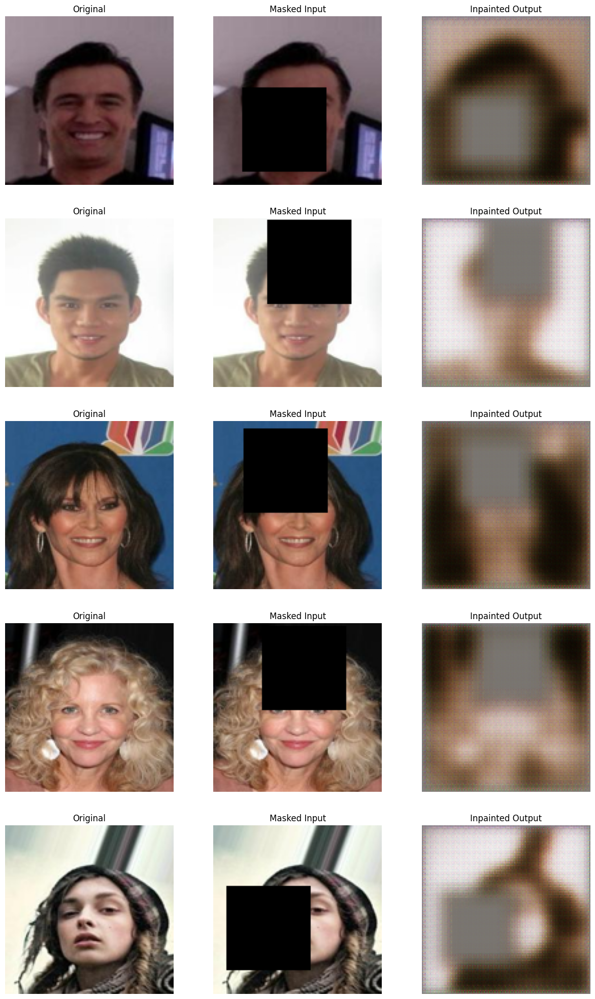

Epoch 2/10 - Gen Loss: 15.1409 - Disc Loss: 0.4184 - PSNR: 13.6203 - SSIM: 0.3396


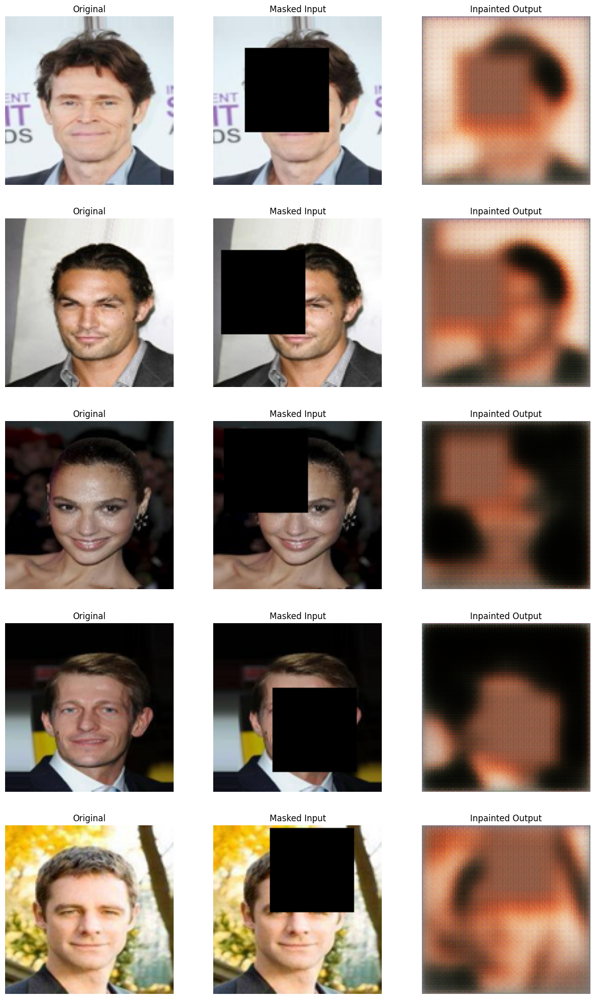

Epoch 3/10 - Gen Loss: 14.1209 - Disc Loss: 0.3047 - PSNR: 15.3956 - SSIM: 0.3588


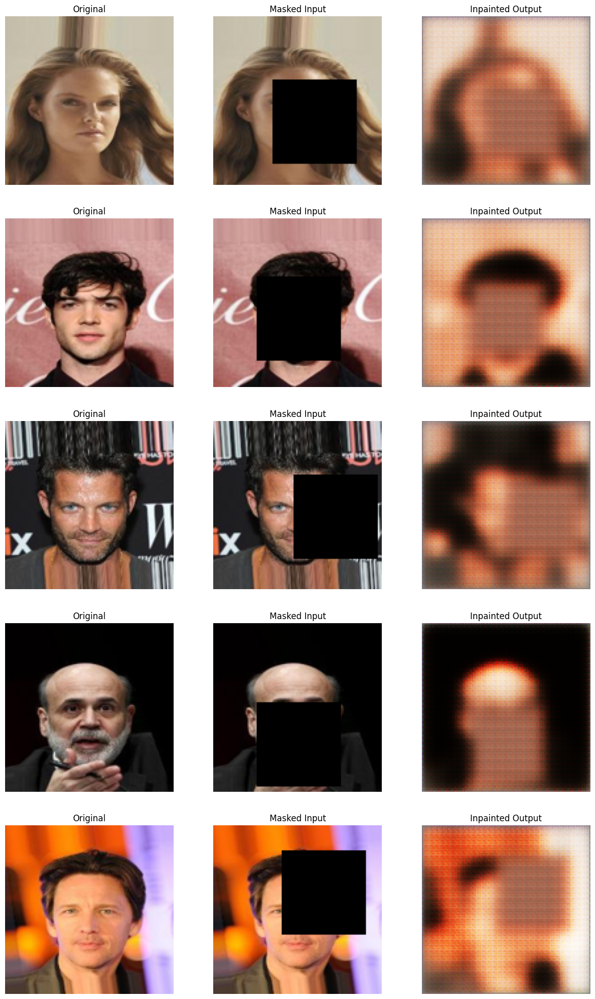

Epoch 4/10 - Gen Loss: 13.6575 - Disc Loss: 0.3062 - PSNR: 16.3913 - SSIM: 0.4274


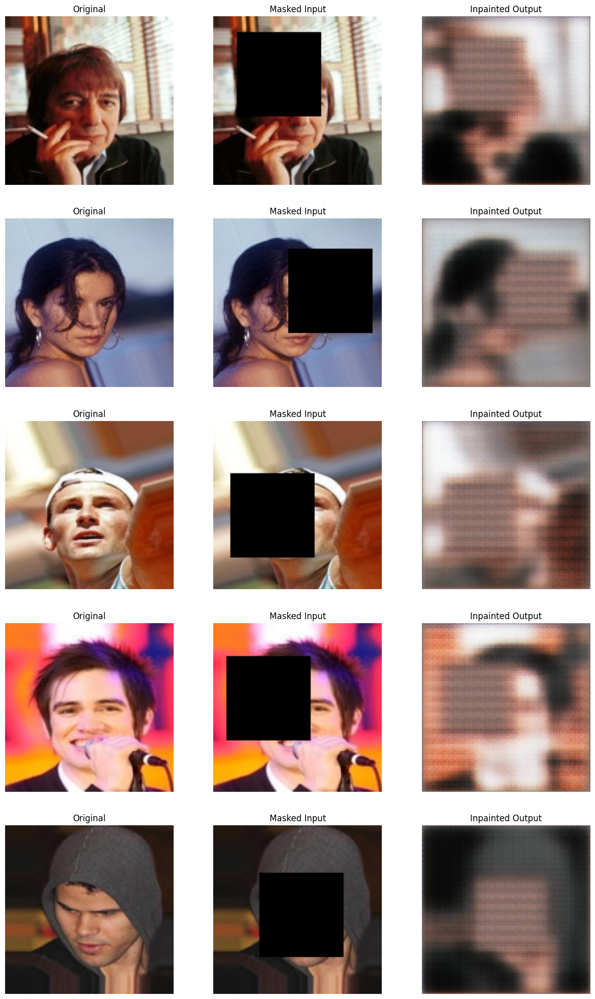

Epoch 5/10 - Gen Loss: 13.1399 - Disc Loss: 0.3175 - PSNR: 17.1323 - SSIM: 0.4408


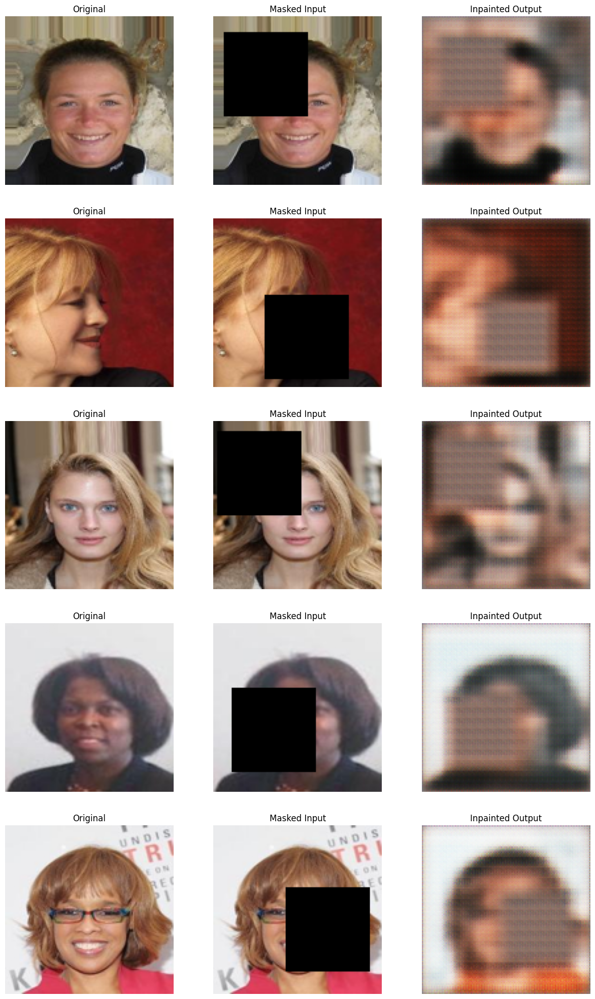

Epoch 6/10 - Gen Loss: 12.5533 - Disc Loss: 0.3237 - PSNR: 16.7404 - SSIM: 0.3929


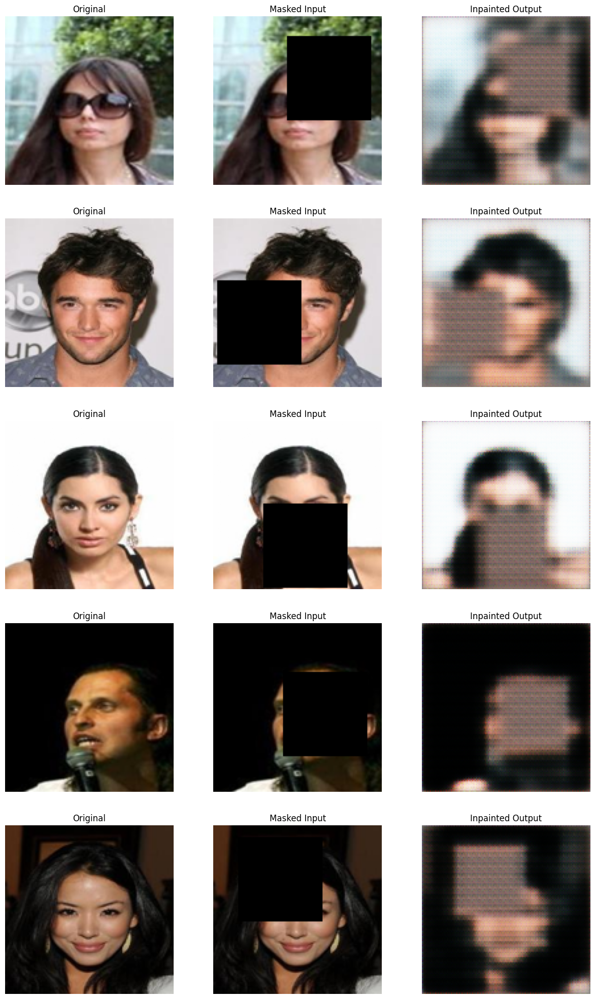

Epoch 7/10 - Gen Loss: 12.4203 - Disc Loss: 0.3144 - PSNR: 16.8200 - SSIM: 0.4231


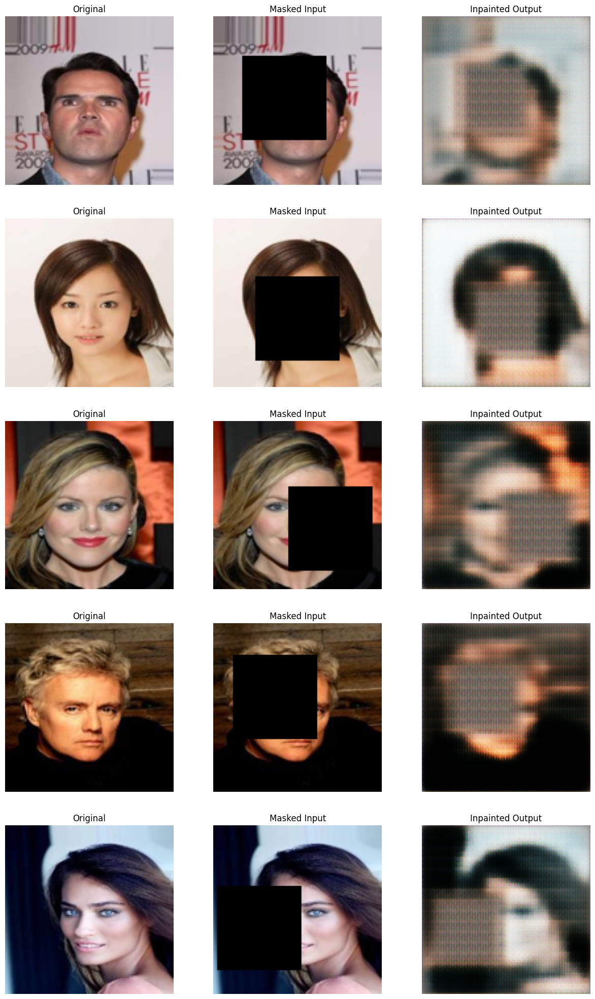

Epoch 8/10 - Gen Loss: 12.3021 - Disc Loss: 0.2616 - PSNR: 17.1728 - SSIM: 0.4217


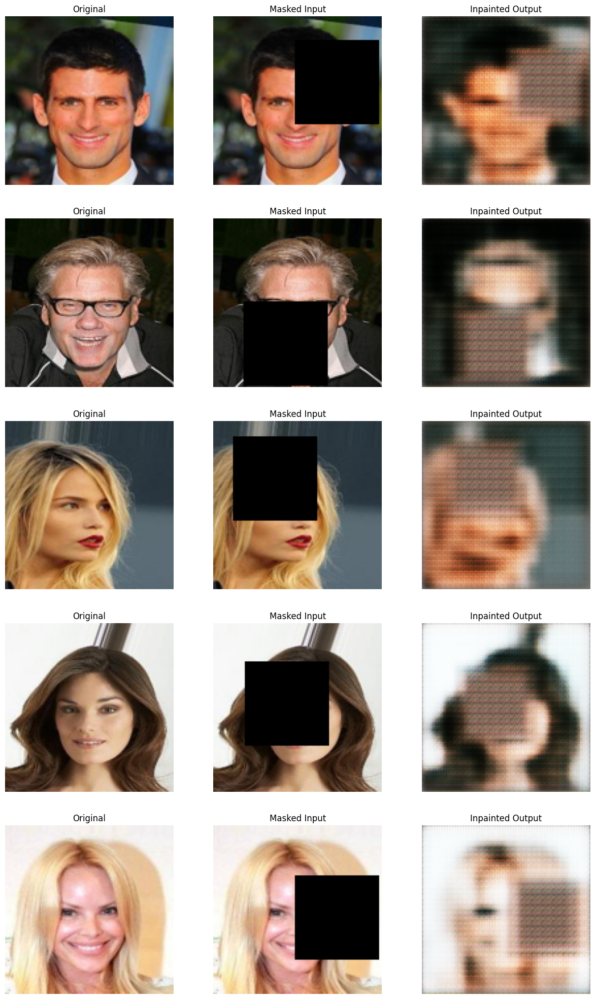

Epoch 9/10 - Gen Loss: 12.1885 - Disc Loss: 0.2278 - PSNR: 17.1809 - SSIM: 0.4309


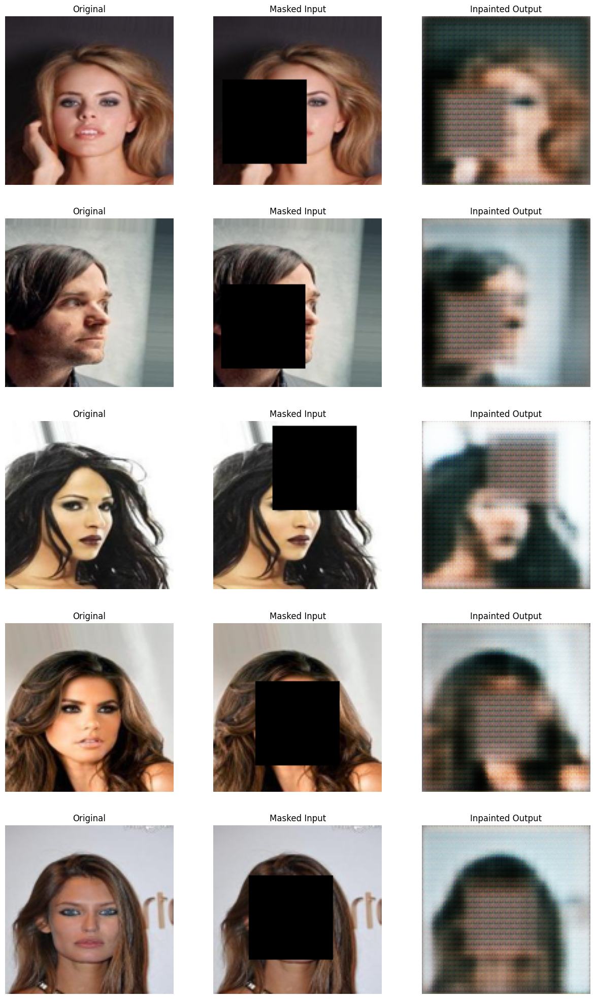

Epoch 10/10 - Gen Loss: 12.2138 - Disc Loss: 0.2303 - PSNR: 17.7593 - SSIM: 0.4844


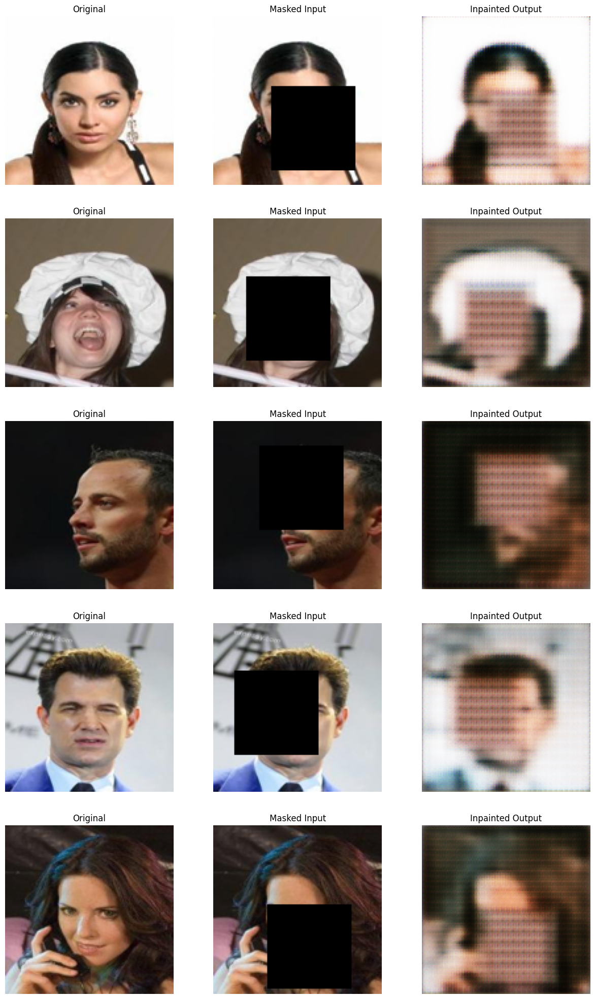

In [81]:
for epoch in range(EPOCHS):
    gen_loss_avg = tf.keras.metrics.Mean()
    disc_loss_avg = tf.keras.metrics.Mean()

    for real_batch, _ in dataset:
        batch_size = real_batch.shape[0]
        masks = create_random_mask(batch_size)
        gen_loss, disc_loss = train_step(real_batch, masks)
        gen_loss_avg.update_state(gen_loss)
        disc_loss_avg.update_state(disc_loss)

    # Evaluate on a batch after epoch
    sample_imgs, _ = next(iter(dataset.take(1)))
    sample_batch_size = sample_imgs.shape[0]
    sample_masks = create_random_mask(sample_batch_size)
    psnr, ssim = evaluate_inpainting(sample_imgs, sample_masks, generator)

    gen_losses.append(gen_loss_avg.result().numpy())
    disc_losses.append(disc_loss_avg.result().numpy())
    psnr_scores.append(psnr)
    ssim_scores.append(ssim)

    print(f"Epoch {epoch+1}/{EPOCHS} - Gen Loss: {gen_loss_avg.result():.4f} - Disc Loss: {disc_loss_avg.result():.4f} - PSNR: {psnr:.4f} - SSIM: {ssim:.4f}")

    # Visualize after every epoch
    show_inpaint_results(sample_imgs.numpy(), sample_masks.numpy(), generator)

---
---

---
---

In [82]:
# Save models

In [83]:
generator.save('saved_models/generator_model.h5')

In [84]:
discriminator.save('saved_models/discriminator_model.h5')

---
---

---
---

In [85]:
# Plot training metrics

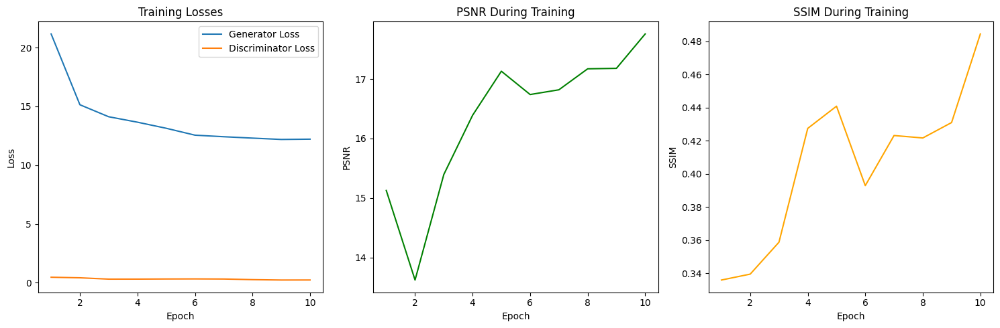

In [86]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(range(1, EPOCHS+1), gen_losses, label='Generator Loss')
plt.plot(range(1, EPOCHS+1), disc_losses, label='Discriminator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Losses')
plt.legend()

plt.subplot(1, 3, 2)
plt.plot(range(1, EPOCHS+1), psnr_scores, color='green')
plt.xlabel('Epoch')
plt.ylabel('PSNR')
plt.title('PSNR During Training')

plt.subplot(1, 3, 3)
plt.plot(range(1, EPOCHS+1), ssim_scores, color='orange')
plt.xlabel('Epoch')
plt.ylabel('SSIM')
plt.title('SSIM During Training')

plt.tight_layout()
plt.savefig('outputs/training_metrics.png')
plt.show()

In [87]:
print("\nFinal Results:")
print(f"Generator Loss: {gen_losses[-1]:.4f}")
print(f"Discriminator Loss: {disc_losses[-1]:.4f}")
print(f"PSNR: {psnr_scores[-1]:.4f}")
print(f"SSIM: {ssim_scores[-1]:.4f}")


Final Results:
Generator Loss: 12.2138
Discriminator Loss: 0.2303
PSNR: 17.7593
SSIM: 0.4844


---
---

<h1 style="color:#1f77b4;">Project Conclusion</h1>

This GAN-based image inpainting project using the <strong><a href="https://www.kaggle.com/datasets/jessicali9530/celeba-dataset" target="_blank">CelebA dataset</a></strong> successfully demonstrates a foundational approach to filling missing regions in face images by leveraging generative adversarial networks. Through dataset preprocessing, mask creation, and GAN training, the model learns to reconstruct plausible content in masked areas.

While the current implementation serves as a solid template, the inpainting quality is limited by the relatively simple architecture, short training duration, and minimal data augmentation. Future improvements could greatly enhance performance by incorporating:

- Deeper and more sophisticated generator and discriminator architectures.

- Advanced loss functions such as perceptual loss or adversarial feature matching.

- Extended training with larger batch sizes and more epochs.

- Diverse and adaptive masking strategies to improve generalization.

- Hyperparameter tuning and optimization techniques.

This project lays a foundation for further research and development in image inpainting and related generative modeling tasks. The codebase and methodology can be adapted to other datasets and problem domains, enabling practical applications in image restoration, editing, and creative content generation.

<h2 style="color:#2ca02c;">References</h2>

- CelebA Dataset: <a href="https://www.kaggle.com/datasets/jessicali9530/celeba-dataset" target="_blank">jessicali9530/celeba-dataset</a>

- TensorFlow: <a href="https://www.tensorflow.org/" target="_blank">tensorflow.org</a>

- Keras: <a href="https://keras.io/" target="_blank">keras.io</a>

- GANs Original Paper: Goodfellow et al., 2014, <a href="https://arxiv.org/abs/1406.2661" target="_blank">Generative Adversarial Nets</a>

- PSNR and SSIM Metrics: Wang et al., 2004, <a href="https://ieeexplore.ieee.org/document/1284395" target="_blank">Image Quality Assessment: From Error Visibility to Structural Similarity</a>

<h2 style="color:#d62728;">Contact</h2>

For any questions, feedback, or collaboration, please reach out to me via email:  
<strong>ericmwaniki2004@gmail.com</strong>

---
---